In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp /content/drive/MyDrive/clean_data.rar /content  

In [ ]:
!cp /content/drive/MyDrive/Validation1.rar /content

In [ ]:
#!unrar x /content/clean_data.rar
!unrar x /content/Validation1.rar

Streaming output truncated to the last 5000 lines.
Extracting  Validation1/Jumping_on_Trampoline/frame3 (111).jpg            50%  OK 
Extracting  Validation1/Jumping_on_Trampoline/frame3 (112).jpg            50%  OK 
Extracting  Validation1/Jumping_on_Trampoline/frame3 (113).jpg            50%  OK 
Extracting  Validation1/Jumping_on_Trampoline/frame3 (114).jpg            50%  OK 
Extracting  Validation1/Jumping_on_Trampoline/frame3 (115).jpg            50%  OK 
Extracting  Validation1/Jumping_on_Trampoline/frame3 (116).jpg            50%  OK 
Extracting  Validation1/Jumping_on_Trampoline/frame3 (117).jpg            50%  OK 
Extracting  Validation1/Jumping_on_Trampoline/frame3 (118).jpg            50%  OK 
Extracting  Validation1/Jumping_on_Trampoline/frame3 (119).jpg            50%  OK 
Extracting  Validation1/Jumping_on_Trampoline/frame3 (12).jpg             50%  OK 
Extracting  Validation1/Jumpi

In [ ]:
import os

Biking_dir= os.path.join("/content/clean data/Biking")
climbing_dir= os.path.join("/content/clean data/Climbing_Stairs")
JOT_dir= os.path.join("/content/clean data/Jumping_on_Trampoline")
jogging_dir= os.path.join("/content/clean data/Running")
#motorcycling_dir= os.path.join('/content/train_frames/motorcycling')
walking_dir= os.path.join("/content/clean data/Walk")

print('total training Biking images:', len(os.listdir(Biking_dir)))
print('total training climbing images:', len(os.listdir(climbing_dir)))
print('total training JOT images:', len(os.listdir(JOT_dir)))
print('total training jogging images:', len(os.listdir(jogging_dir)))
#print('total training motordriving images:', len(os.listdir(motorcycling_dir)))
print('total training walking images:', len(os.listdir(walking_dir)))

Biking_files = os.listdir(Biking_dir)
print(Biking_files[:10])

climbing_files = os.listdir(climbing_dir)
print(climbing_files[:10])

JOT_files = os.listdir(JOT_dir)
print(JOT_files[:10])

jogging_files = os.listdir(jogging_dir)
print(jogging_files[:10])

walking_files = os.listdir(walking_dir)
print(walking_files[:10])

total training Biking images: 30324
total training climbing images: 8689
total training JOT images: 24002
total training jogging images: 16040
total training walking images: 51857
['frame54 (85).jpg', 'frame133 (123).jpg', 'frame44 (127).jpg', 'frame398 (5).jpg', 'frame79 (9).jpg', 'frame249.jpg', 'frame152 (69).jpg', 'frame154 (34).jpg', 'frame4 (58).jpg', 'frame92 (102).jpg']
['frame54 (85).jpg', 'frame79 (9).jpg', 'frame4 (58).jpg', 'frame3 (34).jpg', 'frame61 (33).jpg', 'frame45 (62).jpg', 'frame41 (73).jpg', 'frame68 (66).jpg', 'frame10 (30).jpg', 'frame18 (47).jpg']
['frame54 (85).jpg', 'frame79 (9).jpg', 'frame249.jpg', 'frame152 (69).jpg', 'frame154 (34).jpg', 'frame4 (58).jpg', 'frame92 (102).jpg', 'frame76 (115).jpg', 'frame137 (97).jpg', 'frame135 (43).jpg']
['frame54 (85).jpg', 'frame44 (127).jpg', 'frame79 (9).jpg', 'frame249.jpg', 'frame4 (58).jpg', 'frame3 (34).jpg', 'frame16 (215).jpg', 'frame61 (33).jpg', 'frame45 (62).jpg', 'frame91 (36).jpg']
['frame54 (85).jpg', 'fr

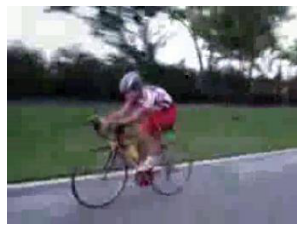

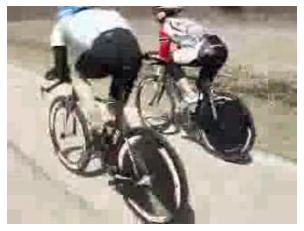

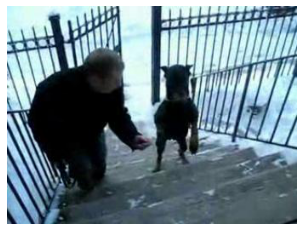

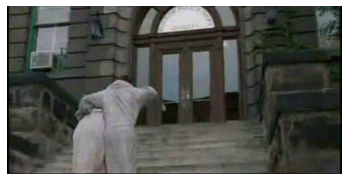

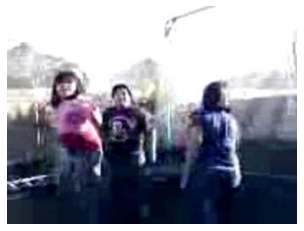

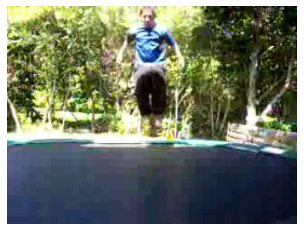

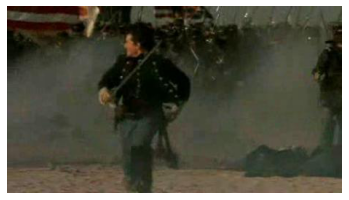

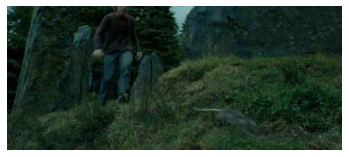

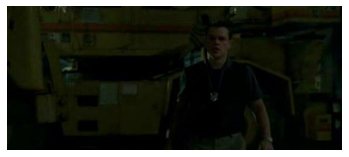

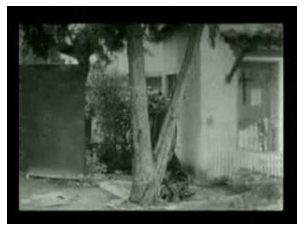

In [ ]:
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

pic_index = 2

next_Biking = [os.path.join(Biking_dir, fname) 
                for fname in Biking_files[pic_index-2:pic_index]]
next_climbing = [os.path.join(climbing_dir, fname) 
                for fname in climbing_files[pic_index-2:pic_index]]
next_JOT = [os.path.join(JOT_dir, fname) 
                for fname in JOT_files[pic_index-2:pic_index]]
next_jogging = [os.path.join(jogging_dir, fname) 
                for fname in jogging_files[pic_index-2:pic_index]]
next_walking = [os.path.join(walking_dir, fname) 
                for fname in walking_files[pic_index-2:pic_index]]

for i, img_path in enumerate(next_Biking+next_climbing+next_JOT+next_jogging+next_walking):
  #print(img_path)
  img = mpimg.imread(img_path)
  plt.imshow(img)
  plt.axis('Off')
  plt.show()

In [ ]:
import tensorflow as tf
import keras_preprocessing
from keras_preprocessing import image
from keras_preprocessing.image import ImageDataGenerator

TRAINING_DIR = "/content/clean data"
training_datagen = ImageDataGenerator(
      rescale = 1./255,
	    rotation_range=40,
      width_shift_range=0.2,
      height_shift_range=0.2,
      shear_range=0.2,
      zoom_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest')

VALIDATION_DIR = "/content/clean data"
validation_datagen = ImageDataGenerator(rescale = 1./255)

train_generator = training_datagen.flow_from_directory(
	TRAINING_DIR,
	target_size=(300,300),
	class_mode='categorical',
  batch_size=126
)

validation_generator = validation_datagen.flow_from_directory(
	VALIDATION_DIR,
	target_size=(300,300),
	class_mode='categorical',
  batch_size=126
)

model = tf.keras.models.Sequential([
    # Note the input shape is the desired size of the image 150x150 with 3 bytes color
    # This is the first convolution
    tf.keras.layers.Conv2D(64, (3,3), activation='relu', input_shape=(300, 300, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    # The second convolution
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    # The third convolution
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    # The fourth convolution
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
  
    # Flatten the results to feed into a DNN
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dropout(0.5),
    # 512 neuron hidden layer
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dense(5, activation='softmax')
])


model.summary()

model.compile(loss = 'categorical_crossentropy', optimizer='rmsprop', metrics=['accuracy'])

history = model.fit(train_generator, epochs=35, steps_per_epoch=20, validation_data = validation_generator, verbose = 1, validation_steps=3)



Found 130912 images belonging to 5 classes.
Found 130912 images belonging to 5 classes.
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_14 (Conv2D)           (None, 298, 298, 64)      1792      
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 149, 149, 64)      0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 147, 147, 64)      36928     
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 73, 73, 64)        0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 71, 71, 128)       73856     
_________________________________________________________________
max_pooling2d_16 (MaxPooling (None, 35, 35, 128)       0         
________________________________

In [ ]:
model.save("HARFinal1.h5")

In [ ]:
!cp /content/HARFinal1.h5 /content/drive/MyDrive

In [ ]:
import tensorflow as tf

model = tf.keras.models.load_model('HAR10.h5')
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()
open("Human_activity.tflite", "wb").write(tflite_model)

INFO:tensorflow:Assets written to: /tmp/tmpewh7zkbu/assets


INFO:tensorflow:Assets written to: /tmp/tmpewh7zkbu/assets


68166412

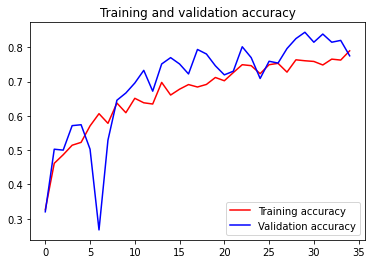

<Figure size 432x288 with 0 Axes>

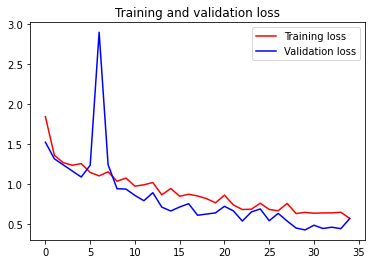

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content
!mkdir output
!mkdir video
%cd video
!mkdir Biking
!mkdir Climbing_
!mkdir Jumping_on_Trampoline
!mkdir Running
!mkdir Walk
!mkdir didnotwork
%cd /content





/content
/content/video
/content


In [ ]:
import numpy as np
from tensorflow import keras
import shutil
import cv2
from google.colab import files
from keras.preprocessing import image
from google.colab.patches import cv2_imshow

array1=[]

mainpath = ""

count1=[0,0,0,0,0,0]

uploaded = files.upload()

model = keras.models.load_model('/content/drive/MyDrive/Finalmodel.h5')


for fn in uploaded.keys():
  path = fn
  mainpath = path
  cap = cv2.VideoCapture(path)

  count=0;
  
  name = chr(ord('a')-1)
  # predicting images
  while(cap.isOpened()): 
      
  # Capture frame-by-frame 
    ret, frame = cap.read() 
    if ret == True: 
        
        #img = image.load_img(frame, target_size=(150, 150))
        #x = image.img_to_array(img)
        img=cv2.resize(frame,(300,300))
        x = np.expand_dims(img, axis=0)
        images = np.vstack([x])
        classes = model.predict(images, batch_size=10)
        if(classes[0][0]==1):
          text="Biking"
          count1[0] = count1[0] + 1
    
        elif(classes[0][1]==1):
          text="Climbing_Stairs"
          count1[1] = count1[1] + 1
    
        elif(classes[0][2]==1):
          text="jumping_on_trampolin"
          count1[2] = count1[2] + 1
    
        elif(classes[0][3]==1):
          text="Running"
          count1[3] = count1[3] + 1
    
        elif(classes[0][4]==1):
          text= 'Walking'
          count1[4] = count1[4] + 1
    
        else:
          text=""
          count1[5] = count1[5] + 1
          
        # font 
        font = cv2.FONT_HERSHEY_SIMPLEX 
          
        # org 
        org = (0, 24) 
          
        # fontScale 
        fontScale = 0.5
          
        # Red color in BGR 
        color = (34, 139, 34) 
          
        # Line thickness of 2 px 
        thickness = 1
          
        # Using cv2.putText() method 
        image = cv2.putText(frame, text, org, font, fontScale,color, thickness, cv2.LINE_AA, False)
        array1.append(image)
        #cv2.imwrite("test.jpg",image)
        
        #cv2_imshow(image)

        """
        if count<10:
            cv2.imwrite("a"+ str(count)+".jpg",image)
            shutil.move("a"+ str(count)+".jpg","/content/output")
            
        elif count>10:
            cv2.imwrite("b"+ str(count)+".jpg",image)
            shutil.move("b"+ str(count)+".jpg","/content/output")
          """
        if count%10 == 0:
          name = chr(ord(name)+1)
          count= 1
        cv2.imwrite(name + str(count)+".jpg",image)
        shutil.move(name + str(count)+".jpg","/content/output") 
        count=count+1
        
    else:
      break

print(count1)
print(mainpath)
  

Saving v_Biking_g20_c06.avi to v_Biking_g20_c06.avi
[358, 0, 0, 0, 0, 0]
v_Biking_g20_c06.avi


In [ ]:
!pwd

/content


In [ ]:
%cd /content
!rm -r  /content/output
!mkdir output

/content


In [ ]:
!mkdir video
%cd video
!mkdir Biking
!mkdir Climbing_
!mkdir Jumping_on_Trampoline
!mkdir Running
!mkdir Walk
!mkdir didnotwork
%cd /content


mkdir: cannot create directory ‘video’: File exists
/content/video
mkdir: cannot create directory ‘Biking’: File exists
mkdir: cannot create directory ‘Climbing_’: File exists
mkdir: cannot create directory ‘Jumping_on_Trampoline’: File exists
mkdir: cannot create directory ‘Running’: File exists
mkdir: cannot create directory ‘Walk’: File exists
mkdir: cannot create directory ‘didnotwork’: File exists
/content


In [ ]:
import cv2
import numpy as np
import os
import shutil
import cv2 
from PIL import Image 


height,width,layers=array1[1].shape

video=cv2.VideoWriter('/content/video.avi',cv2.VideoWriter_fourcc(*'DIVX'),13,(width,height))

array2=[]

l=len(array1)

for i in range(l):
  array2=cv2.cvtColor(array1[i], cv2.COLOR_RGB2GRAY)


for j in range(l):
  
  video.write(array1[j])

cv2.destroyAllWindows()
video.release()

In [ ]:
# importing libraries 
import os
import shutil
import cv2 
from PIL import Image 

mainpath = '/content/'+mainpath

# Checking the current directory path 
print(os.getcwd()) 

# Folder which contains all the images 
# from which video is to be generated 
os.chdir("/content/output") 
path = "/content/output"

mean_height = 0
mean_width = 0

num_of_images = len(os.listdir('.')) 
print(num_of_images) 

for file in os.listdir('.'): 
	im = Image.open(os.path.join(path, file)) 
	width, height = im.size 
	mean_width += width 
	mean_height += height 
	# im.show() # uncomment this for displaying the image 

# Finding the mean height and width of all images. 
# This is required because the video frame needs 
# to be set with same width and height. Otherwise 
# images not equal to that width height will not get 
# embedded into the video 
mean_width = int(mean_width / num_of_images) 
mean_height = int(mean_height / num_of_images) 

# print(mean_height) 
# print(mean_width) 

# Resizing of the images to give 
# them same width and height 
for file in os.listdir('.'): 
	if file.endswith(".jpg") or file.endswith(".jpeg") or file.endswith("png"): 
		# opening image using PIL Image 
		im = Image.open(os.path.join(path, file)) 

		# im.size includes the height and width of image 
		width, height = im.size 
		#print(width, height) 

		# resizing 
		imResize = im.resize((mean_width, mean_height), Image.ANTIALIAS) 
		imResize.save( file, 'JPEG', quality = 25) # setting quality 
		# printing each resized image name 
		#print(im.filename.split('\\')[-1], " is resized") 


# Video Generating function 
def generate_video(): 
	image_folder = '.' # make sure to use your folder 
	video_name = 'mygeneratedvideo.avi'
	os.chdir("/content/output") 
	
	images = [img for img in os.listdir(image_folder) 
			if img.endswith(".jpg") or
				img.endswith(".jpeg") or
				img.endswith("png")] 
	
	# Array images should only consider 
	# the image files ignoring others if any 
	#print(images) 

	frame = cv2.imread(os.path.join(image_folder, images[0])) 

	# setting the frame width, height width 
	# the width, height of first image 
	height, width, layers = frame.shape 

	video = cv2.VideoWriter(video_name, cv2.VideoWriter_fourcc(*'DIVX'),8,(width, height)) 

	# Appending the images to the video one by one 
	for image in images: 
		video.write(cv2.imread(os.path.join(image_folder, image))) 
	
	# Deallocating memories taken for window creation 
	cv2.destroyAllWindows() 
	video.release() # releasing the video generated 


# Calling the generate_video function 
generate_video() 

pos = count1.index(max(count1))
if pos == 0:
  shutil.move(mainpath,'/content/video/Biking')
elif pos == 1:
  shutil.move(mainpath,'/content/video/Climbing_strairs')
elif pos == 2:
  shutil.move(mainpath,'/content/video/Jumping_on_Trampoline')
elif pos == 3:
  shutil.move(mainpath,'/content/video/Running')
elif pos == 4:
  shutil.move(mainpath,'/content/video/Walk')
else:
  shutil.move(mainpath,'/content/video/didnotwork')


/content
358


(240, 320, 3)


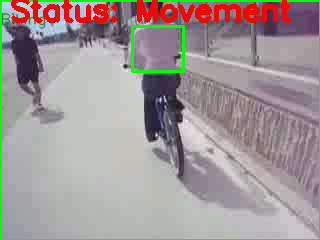

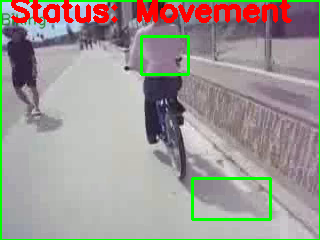

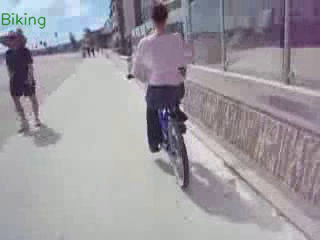

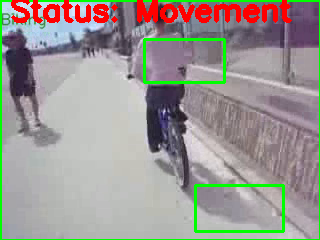

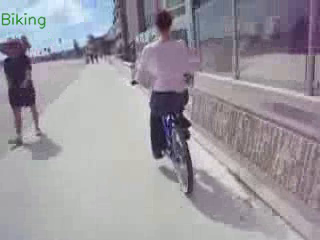

...

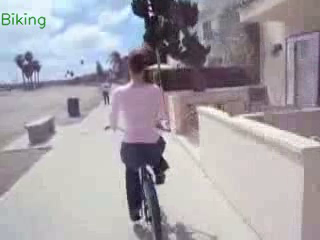

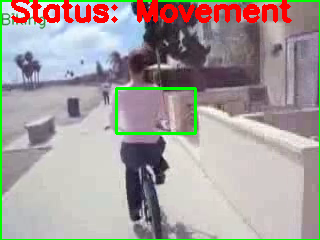

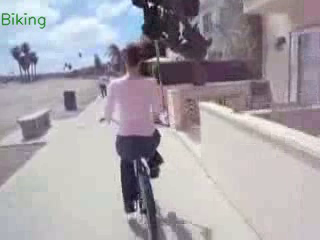

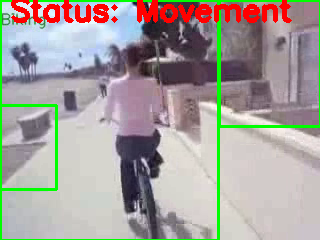

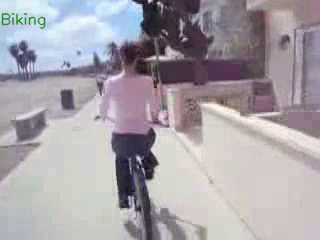

error: ignored

In [ ]:
import cv2
import numpy as np

cap = cv2.VideoCapture("/content/video.avi")
frame_width = int( cap.get(cv2.CAP_PROP_FRAME_WIDTH))

frame_height =int( cap.get( cv2.CAP_PROP_FRAME_HEIGHT))

fourcc = cv2.VideoWriter_fourcc('X','V','I','D')

out = cv2.VideoWriter("output.avi", fourcc, 5.0, (1280,720))

ret, frame1 = cap.read()
ret, frame2 = cap.read()
print(frame1.shape)
while cap.isOpened():
    diff = cv2.absdiff(frame1, frame2)
    gray = cv2.cvtColor(diff, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5,5), 0)
    _, thresh = cv2.threshold(blur, 20, 255, cv2.THRESH_BINARY)
    dilated = cv2.dilate(thresh, None, iterations=3)
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    for contour in contours:
        (x, y, w, h) = cv2.boundingRect(contour)

        if cv2.contourArea(contour) < 900:
            continue
        cv2.rectangle(frame1, (x, y), (x+w, y+h), (0, 255, 0), 2)
        cv2.putText(frame1, "Status: {}".format('Movement'), (10, 20), cv2.FONT_HERSHEY_SIMPLEX,
                    1, (0, 0, 255), 3)
    #cv2.drawContours(frame1, contours, -1, (0, 255, 0), 2)

    image = cv2.resize(frame1, (1280,720))
    out.write(image)
    #cv2_imshow(frame1)
    frame1 = frame2
    ret, frame2 = cap.read()

    if cv2.waitKey(40) == 27:
        break

cv2.destroyAllWindows()
cap.release()
out.release()

In [ ]:
from moviepy.editor import *

path="/content/video.avi" 

clip=VideoFileClip(path)
clip.ipython_display(width=280)

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)2105344/45929032 bytes (4.6%)5791744/45929032 bytes (12.6%)9068544/45929032 bytes (19.7%)12533760/45929032 bytes (27.3%)15941632/45929032 bytes (34.7%)19521536/45929032 bytes (42.5%)23027712/45929032 bytes (50.1%)26599424/45929032 bytes (57.9%)30048256/45929032 bytes (65.4%)33521664/45929032 bytes (73.0%)36790272/45929032 bytes (80.1%)40288256/45929032 bytes (87.7%)

100%|██████████| 359/359 [00:00<00:00, 615.88it/s]
